In [1]:
import shap
from tqdm import tqdm
from importlib import import_module
from utils.training_utils import ModelCheckpoint
from config import Config
from data_generator import DataLoader
config = Config
import warnings
import matplotlib.pyplot as plt
warnings.filterwarnings("ignore")

In [2]:
import torch
torch.cuda.is_available = lambda : False
device = torch.device('cuda:0' if torch.cuda.is_available() else 'cpu')
device

device(type='cpu')

In [3]:
model_type = import_module('models.' + config.architecture)
create_model = getattr(model_type, 'create_model')

In [4]:
if config.k_fold:
    models = []
    for fold in range(len(config.k_fold_splits)):
        config.fold = fold + 1
        model = create_model(config)
        model_checkpoint = ModelCheckpoint(config=config)
        model, _, _, _ = model_checkpoint.load(model, load_best=True)
        models.append(model)

In [5]:
data_loader = DataLoader(config)
ids = data_loader.ids
test_loader = data_loader.create_test_loader()

In [6]:
model = models[0].to('cpu')
model.train()
for i, [x, norm_factor] in enumerate(tqdm(test_loader)):
    x = [inp.float().to('cpu') for inp in x]
    norm_factor = norm_factor.to(config.device)
    #preds.append((model(*x) * norm_factor[:, None]).data.cpu().numpy())
    e = shap.DeepExplainer(model, x)
    shap_values = e.shap_values(x)
    break

  0%|          | 0/239 [00:00<?, ?it/s]

  0%|          | 0/239 [10:34:25<?, ?it/s]


In [9]:
len(shap_values)
import numpy as np

In [10]:
len(shap_values)

28

In [11]:
shap_list = []
for i in range(7):
    arr = []
    for j in range(28):
        arr.append(shap_values[j][i])
    print(np.mean(arr, axis=(0,1,2)).shape)
    shap_list.append(np.mean(arr, axis=(0,1,2)))

(37,)
(5,)
(2,)
(11,)
(5,)
(2,)
(16,)


In [68]:
feature_names = ['prev_day_sales',
                 'snap_CA', 'snap_TX', 'snap_WI',
                 'relative_year', 'month_sin', 'month_cos',
                 'day_sin', 'day_cos',
                 'weekday_sin', 'weekday_cos',
                 'pre_day_sales', 
                 'lag1', 'lag2', 'lag3', 'lag4', 'lag5', 
                 'lag6', 'lag7', 'lag8', 'lag9', 'lag10', 
                 'lag11', 'lag12', 'lag13', 'lag14', 'lag15',
                 'roll_7_mean', 'roll_14_mean', 'roll_30_mean', 'roll_60_mean', 'roll_180_mean',
                 'roll_7_std', 'roll_14_std', 'roll_30_std', 'roll_60_std', 'roll_180_std',]

In [69]:
len(feature_names)

37

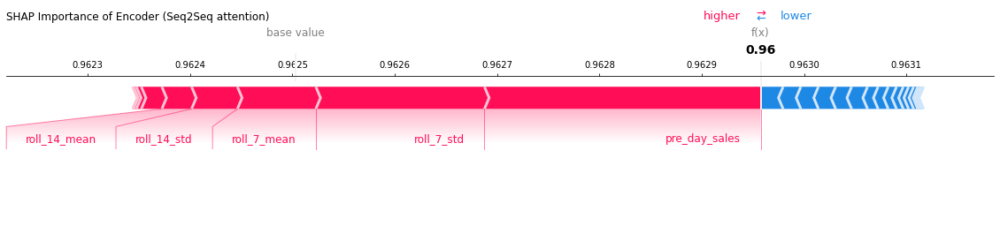

In [70]:
shap.plots.force(e.expected_value[0], shap_list[0], feature_names=feature_names, show=False, matplotlib=True)
plt.title('SHAP Importance of Encoder (Seq2Seq attention)', y=1.35, loc='left')
plt.savefig('encoder_importance.png', dpi=100, bbox_inches='tight')

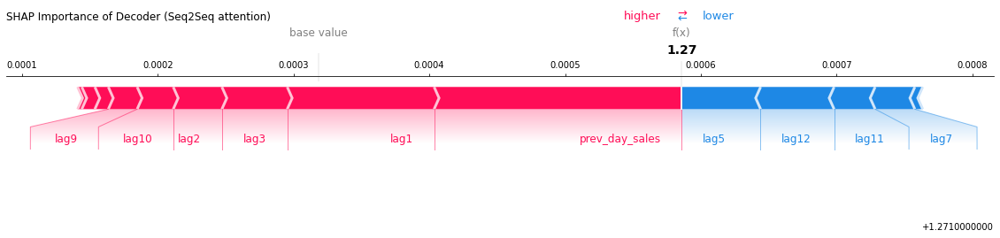

In [71]:

feature_names = ['prev_day_sales', 'lag1', 'lag2', 'lag3', 'lag4', 'lag5', 'lag6', 'lag7', 'lag8', 'lag9', 'lag10', 'lag11', 'lag12', 'lag13', 'lag14', 'lag15']
shap.plots.force(e.expected_value[6], shap_list[6], feature_names=feature_names, show=False, matplotlib=True)
plt.title('SHAP Importance of Decoder (Seq2Seq attention)', y=1.35, loc='left')
plt.savefig('decoder_importance.png', dpi=100, bbox_inches='tight')

In [8]:
for i in shap_values[0]:
    print(i.shape)

(4, 364, 37)
(4, 364, 5)
(4, 364, 2)
(4, 28, 11)
(4, 28, 5)
(4, 28, 2)
(4, 28, 16)
